# Introduction

In this notebook, we conduct an open exploration of the model in which no policies are implemented (Base Case), and 8 randomly selected levers are implemented (With Policy). Thus, in the base case, we are able to obtain an overview of outcomes in the IJsseldelta when no actions are taken, and compare these outcomes to cases where _some_ action is taken (i.e., with the randomly sampled levers).

We conducted this open exploration exercise with 5000 scenarios in the base case, and 3000* scenarios for 8 randomly sampled levers. These scenarios and levers which were sampled using Latin Hypercube Sampling. The benefit of LHS in this case is that it can sample as widely across the uncertainty and policy spaces as possible, which are complex and consist of parameters of various complexity (i.e., categorical vs. continuous integer ranges) and length (e.g., 3-5 days for the Emergency Warning System, and 0-10dm for extent of dike heightening). __Source?__

Subsequently, using scenario discovery, we were able to generate an understanding of the scenarios that lead to the worst-case outcomes. Using some visualization techniques, we were also able to gain a brief overview of the policy space.

_*less scenarios were sampled in open exploration with policy due to limited access to computational power_

## 0.0 Import libraries

In [2]:
from ema_workbench import (Model, RealParameter, ScalarOutcome, CategoricalParameter, IntegerParameter,
                           SequentialEvaluator, MultiprocessingEvaluator, ema_logging,
                           Policy, Constant, Scenario, Constraint, save_results, load_results)
from ema_workbench.analysis import parcoords, prim
from ema_workbench.em_framework import optimization
from ema_workbench.em_framework.samplers import sample_uncertainties
from ema_workbench.em_framework.evaluators import BaseEvaluator
from ema_workbench.em_framework.optimization import (HyperVolume, EpsilonProgress)
from problem_formulation import get_model_for_problem_formulation
ema_logging.log_to_stderr(ema_logging.INFO)

import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from plotly.tools import FigureFactory as ff
from PIL import Image
from plotly.subplots import make_subplots
import plotly
import chart_studio.plotly as py
import chart_studio
import plotly.graph_objs as go
import plotly.express as px
from scipy.stats import mstats
import warnings
from scipy.stats import mstats

## 1.0 Experimentation
### 1.1 Select problem formulation
For open exploration, we selected Problem Formulation 3, which yields 12 outcomes:
* Total Costs at each dike ring location
* Expected Number of Deaths at each dike ring location
* RfR Total Costs
* Expected Evacuation Costs

In [3]:
model, steps = get_model_for_problem_formulation(3)

In [4]:
model_uncertainties = []
for i in model.uncertainties:
    model_uncertainties.append(i.name)

In [5]:
model_levers = []
for i in model.levers:
    model_levers.append(i.name)

In [6]:
model_outcomes = []
for i in model.outcomes:
    model_outcomes.append(i.name)

### 1.2 Experimental Set-up

Base Case: we defined all policies as 0, which indicates no action.

In [ ]:
# policies = [Policy("base case", **{k.name: 0 for k in model.levers})]

In [ ]:
# with MultiprocessingEvaluator(model) as evaluator:
#     results = evaluator.perform_experiments(scenarios=5000, policies=policies)

In [ ]:
# save_results(results, "results/open-exploration/open_exploration_basecase_pf3.tar.gz")

With Policy: we randomly sampled 8 policies using LHS (default sampler).

In [ ]:
# with MultiprocessingEvaluator(model) as evaluator:
#     results = evaluator.perform_experiments(scenarios=3000, policies=8)

In [ ]:
# save_results(results, "results/open-exploration/open_exploration_basecase_pf3.tar.gz")

## 2.0 Analysis of Results

In [7]:
experiments_bc, outcomes_bc = load_results("results/open-exploration/open_exploration_basecase_pf3.tar.gz")

[MainProcess/INFO] results loaded succesfully from C:\Users\Leonardo\OneDrive\Documents\TU_Delft\EPA_Year1\EPA1361\assignments\epa1361_open\final assignment\final\Final Results\results\open-exploration\open_exploration_basecase_pf3.tar.gz


In [8]:
experiments_policy, outcomes_policy = load_results("results/open-exploration/open_exploration_withpolicies_pf3.tar.gz")

[MainProcess/INFO] results loaded succesfully from C:\Users\Leonardo\OneDrive\Documents\TU_Delft\EPA_Year1\EPA1361\assignments\epa1361_open\final assignment\final\Final Results\results\open-exploration\open_exploration_withpolicies_pf3.tar.gz


In [9]:
policies_bc = experiments_bc['policy']

data = pd.DataFrame.from_dict(outcomes_bc)
data['policy'] = policies_bc

uncertainties_bc = experiments_bc[model_uncertainties]
uncertainties_outcomes_bc = pd.concat([uncertainties_bc, data], axis=1)

policies_policy = experiments_policy['policy']

data = pd.DataFrame.from_dict(outcomes_policy)
data['policy'] = policies_policy

uncertainties_policy = experiments_policy[model_uncertainties]
uncertainties_outcomes_policy = pd.concat([uncertainties_policy, data], axis=1)

uncertainties_outcomes = [uncertainties_outcomes_bc, uncertainties_outcomes_policy]

In [10]:
for pf in uncertainties_outcomes:
    # total Bmax
    outcomes_cols = []
    outcome_of_interest = "Bmax"
    for i in pf.columns:
        if outcome_of_interest in i:
            outcomes_cols.append(i)
    pf["avg_" + str(outcome_of_interest)] = pf[outcomes_cols].mean(axis=1)

    # total Brate
    outcomes_cols = []
    outcome_of_interest = "Brate"
    for i in pf.columns:
        if outcome_of_interest in i:
            outcomes_cols.append(i)
    pf["avg_" + str(outcome_of_interest)] = pf[outcomes_cols].mean(axis=1)

    # total pfail
    outcomes_cols = []
    outcome_of_interest = "pfail"
    for i in pf.columns:
        if outcome_of_interest in i:
            outcomes_cols.append(i)
    pf["avg_" + str(outcome_of_interest)] = pf[outcomes_cols].mean(axis=1)

uncertainties_outcomes_bc = uncertainties_outcomes[0].iloc[:,16:]
uncertainties_outcomes_policy = uncertainties_outcomes[1].iloc[:,16:]

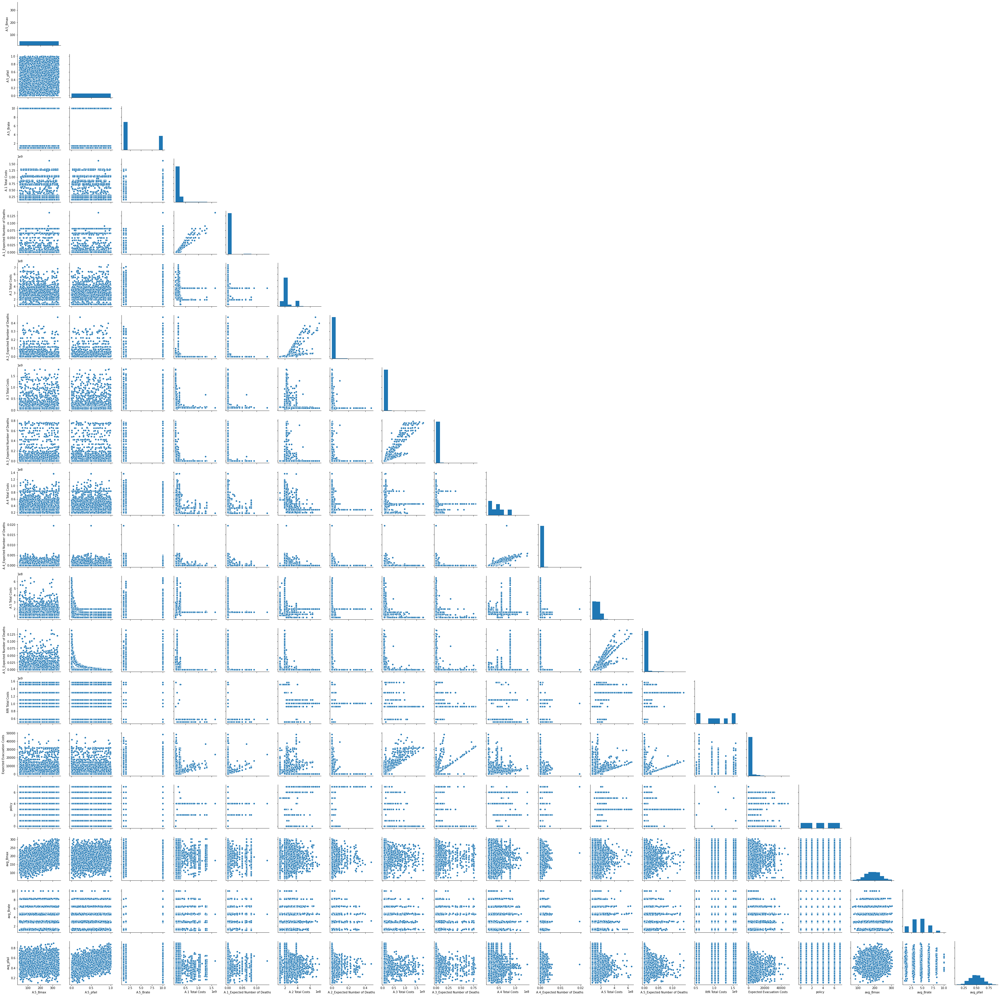

In [16]:
g = sns.pairplot(uncertainties_outcomes_policy, diag_kind='hist')
for i, j in zip(*np.triu_indices_from(g.axes, 1)):
    g.axes[i, j].set_visible(False)
plt.show()
g.savefig('figures/OE_pf1.png', dpi = 300)

In [11]:
# g = sns.pairplot(uncertainties_outcomes_policy, diag_kind='hist', hue = 'Total Investment Costs')
# for i, j in zip(*np.triu_indices_from(g.axes, 1)):
#     g.axes[i, j].set_visible(False)
# plt.show()

In [15]:
uncertainties_outcomes_melt_bc = pd.melt(uncertainties_outcomes_bc, value_vars = uncertainties_outcomes_bc.columns[:-4], id_vars = 'policy')
uncertainties_outcomes_melt_bc.columns = ['Policy', 'Outcome','Value']

uncertainties_outcomes_melt_policy = pd.melt(uncertainties_outcomes_policy, value_vars = uncertainties_outcomes_policy.columns[:-4], id_vars = 'policy')
uncertainties_outcomes_melt_policy.columns = ['Policy', 'Outcome','Value']

# uncertainties and outcomes for pf3 base case AND policies
uncertainties_outcomes_3_melt_p_np = pd.concat([uncertainties_outcomes_melt_policy, uncertainties_outcomes_melt_bc], axis = 0)

In [16]:
uncertainties_outcomes_3_melt_p_np['Policy'] = uncertainties_outcomes_3_melt_p_np['Policy'].astype('str')
uncertainties_outcomes_3_melt_p_np['Policy Type'] = "Policy " + uncertainties_outcomes_3_melt_p_np['Policy']
uncertainties_outcomes_3_melt_p_np['color'] = ''
uncertainties_outcomes_3_melt_p_np['color'][uncertainties_outcomes_3_melt_p_np['Policy'] == 'base case'] = 'red'
uncertainties_outcomes_3_melt_p_np['color'][uncertainties_outcomes_3_melt_p_np['Policy'] != 'base case'] = 'blue'

In [28]:

fig = px.box(uncertainties_outcomes_3_melt_p_np.sort_values('Policy', ascending = False), 
           x = 'Policy Type', y = 'Value', color = "color", facet_row = 'Outcome',
             template='plotly_white',
             notched=False, # used notched shape
#              points='all',
             color_discrete_sequence=px.colors.qualitative.Pastel,
             title="Pf3: Effect of No Intervention on Outcomes",
            width = 2000, height = 2000)

fig['layout']['yaxis']['title']['text']=''
fig['layout']['yaxis1']['title']['text']=''
fig['layout']['yaxis2']['title']['text']=''
fig['layout']['yaxis3']['title']['text']=''
fig['layout']['yaxis4']['title']['text']=''
fig['layout']['yaxis5']['title']['text']=''
fig['layout']['yaxis6']['title']['text']=''
fig['layout']['yaxis7']['title']['text']=''
fig['layout']['yaxis8']['title']['text']=''
fig['layout']['yaxis9']['title']['text']=''
fig['layout']['yaxis10']['title']['text']=''
fig['layout']['yaxis11']['title']['text']=''
fig['layout']['yaxis12']['title']['text']=''
                                    
fig.update_layout(showlegend=False, font = {'size': 9})
fig.update_traces(boxpoints=False, jitter=0.9, marker=dict(size=2, opacity=0.5), pointpos=0)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.update_yaxes(matches=None)
# fig.update_yaxes(range = [0, 2e9])
#py.iplot(fig, filename = 'CT_box', auto_open=True)
fig.show()
fig.write_image("figures/OE_pf3_box.png", scale = 3)

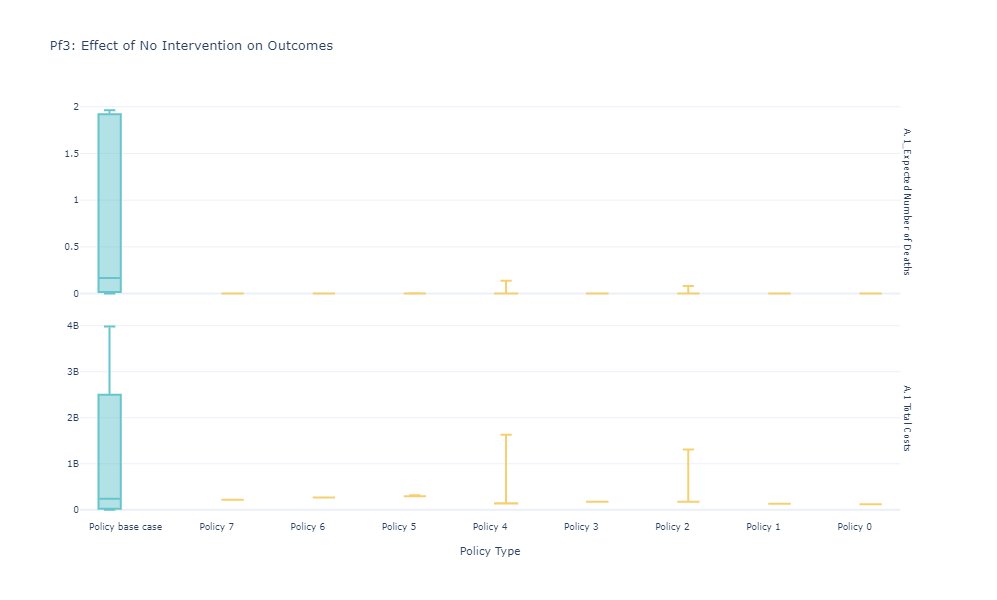

In [29]:
fig = px.box(uncertainties_outcomes_3_melt_p_np[uncertainties_outcomes_3_melt_p_np['Outcome'].isin(['A.1 Total Costs', 
                                                                                                    'A.1_Expected Number of Deaths'])].sort_values('Policy', ascending = False), 
           x = 'Policy Type', y = 'Value', color="color", facet_row = 'Outcome',
             template='plotly_white',
             notched=False, # used notched shape
#              points='all',
             color_discrete_sequence=px.colors.qualitative.Pastel,
             title="Pf3: Effect of No Intervention on Outcomes",
            width = 1000, height = 600)

fig['layout']['yaxis']['title']['text']=''
fig['layout']['yaxis1']['title']['text']=''
fig['layout']['yaxis2']['title']['text']=''
# fig['layout']['yaxis3']['title']['text']=''
# fig['layout']['yaxis4']['title']['text']=''
# fig['layout']['yaxis5']['title']['text']=''
# fig['layout']['yaxis6']['title']['text']=''
# fig['layout']['yaxis7']['title']['text']=''
# fig['layout']['yaxis8']['title']['text']=''
# fig['layout']['yaxis9']['title']['text']=''
# fig['layout']['yaxis10']['title']['text']=''
# fig['layout']['yaxis11']['title']['text']=''
# fig['layout']['yaxis12']['title']['text']=''
                                    
fig.update_layout(showlegend=False, font = {'size': 9})
fig.update_traces(boxpoints=False, jitter=0.9, marker=dict(size=2, opacity=0.5), pointpos=0)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.update_yaxes(matches=None)
# fig.update_yaxes(range = [0, 2e9])
#py.iplot(fig, filename = 'CT_box', auto_open=True)
fig.show()
fig.write_image("figures/OE_pf3_box_costs_deaths_A1.png", scale = 3)